### Project Overview: Employee Attrition & Baltimore Crime Visualization

This project includes two main components:

1. **IBM HR Analytics: Employee Attrition & Performance Classification**
   We analyzed IBM's HR analytics data to predict employee attrition and performance. Using algorithms like Logistic Regression, Random Forest, and K-Nearest Neighbors, we identified key factors influencing employee retention.


2. **Interactive Data Map: Baltimore Crime Dataset**
   We created an interactive map of crime data in Baltimore using **Folium**. The map visualizes arrest locations with color-coded circles indicating gender, helping to identify geographical patterns in arrests.

    **Contributors:**
   - **Matheshwara** UID: 121181500
   - **Abhishek**    UID: 121305534

### Problem -1

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_regression

In [3]:
# Simulate data for linear regression
gen_data_x, gen_data_y = make_regression(n_samples=100, n_features=20, noise=1.5)

# Normalize features
X_mean = np.mean(gen_data_x, axis=0)
X_std = np.std(gen_data_x, axis=0)
gen_data_x_normalized = (gen_data_x - X_mean) / X_std

# Add bias column (intercept)
gen_data_x_with_bias = np.hstack((np.ones((gen_data_x_normalized.shape[0], 1)), gen_data_x_normalized))

# Convert y to column vector
gen_data_y = gen_data_y.reshape(-1, 1)

In [4]:
def gradient_descent_linear(X, y, learning_rate=0.01, epochs=1000):
    """
    Implements gradient descent for multiple linear regression.

    Parameters:
    - X: Feature matrix (including bias/intercept)
    - y: Target vector
    - learning_rate: Learning rate
    - epochs: Number of iterations

    Returns:
    - weights: Final weights
    - loss_history: List of loss values
    """
    m, n = X.shape
    weights = np.zeros((n, 1))
    loss_history = []

    for epoch in range(epochs):
        # Compute predictions
        predictions = X @ weights

        # Compute error
        errors = predictions - y

        # Compute gradient
        gradient = (1 / m) * (X.T @ errors)

        # Update weights
        weights -= learning_rate * gradient

        # Compute loss
        loss = (1 / (2 * m)) * np.sum(errors ** 2)
        loss_history.append(loss)

    return weights, loss_history

In [5]:
# Train linear regression model
linear_weights, linear_loss_history = gradient_descent_linear(gen_data_x_with_bias, gen_data_y, learning_rate=0.01, epochs=1000)

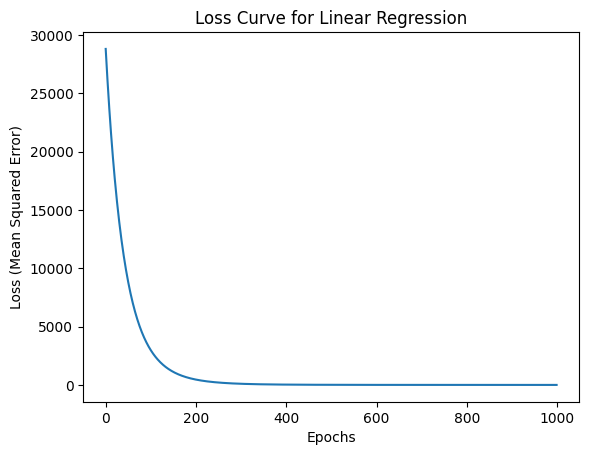

In [6]:
# Plot the loss curve
plt.plot(range(len(linear_loss_history)), linear_loss_history)
plt.xlabel('Epochs')
plt.ylabel('Loss (Mean Squared Error)')
plt.title('Loss Curve for Linear Regression')
plt.show()

### Problem -2

The goal is to derive the logistic regression update rule based on gradient descent:

$$
w = w - \alpha \frac{1}{n} \sum_{i=1}^n \left( h_{\theta}(x_i) - y_i \right) x_i
$$

where:

1. **Hypothesis Function**: The logistic regression hypothesis function, denoted as $$ h_{\theta}(x_i) $$, is given by the sigmoid function:
   $$
   h_{\theta}(x_i) = \frac{e^{\theta^T x_i}}{1 + e^{\theta^T x_i}}
   $$

2. **Linear Combination**: The term $$ \theta^T x_i $$ represents the linear combination of the weights $$ \theta $$ and the input features $$ x_i $$:
   $$
   \theta^T x_i = \theta_0 + \theta_1 x_{i1} + \theta_2 x_{i2} + \dots + \theta_p x_{ip}
   $$

#### Step 1: Cost Function Derivation

The cost function $$ J(\theta) $$ for logistic regression is defined as the negative log-likelihood:

$$
J(\theta) = -\frac{1}{n} \sum_{i=1}^n \left( y_i \log(h_{\theta}(x_i)) + (1 - y_i) \log(1 - h_{\theta}(x_i)) \right)
$$

#### Step 2: Gradient of the Cost Function

To minimize $$ J(\theta) $$, we compute its partial derivative with respect to each weight $$ \theta_j $$:

$$
\frac{\partial J(\theta)}{\partial \theta_j} = -\frac{1}{n} \sum_{i=1}^n \left( y_i \frac{1}{h_{\theta}(x_i)} \frac{\partial h_{\theta}(x_i)}{\partial \theta_j} - (1 - y_i) \frac{1}{1 - h_{\theta}(x_i)} \frac{\partial h_{\theta}(x_i)}{\partial \theta_j} \right)
$$

#### Step 3: Simplifying the Derivative Using the Sigmoid Function

Given that $$ h_{\theta}(x_i) = \frac{1}{1 + e^{-\theta^T x_i}} $$, we find:

$$
\frac{\partial h_{\theta}(x_i)}{\partial \theta_j} = h_{\theta}(x_i) (1 - h_{\theta}(x_i)) x_{ij}
$$

Substituting this into our derivative expression yields:

$$
\frac{\partial J(\theta)}{\partial \theta_j} = \frac{1}{n} \sum_{i=1}^n (h_{\theta}(x_i) - y_i) x_{ij}
$$

#### Step 4: Update Rule for Gradient Descent

The update rule for gradient descent for each weight $$ \theta_j $$ is given by:

$$
\theta_j := \theta_j - \alpha \frac{\partial J(\theta)}{\partial \theta_j}
$$

Substituting our earlier result, we have:

$$
\theta_j := \theta_j - \alpha \cdot \frac{1}{n} \sum_{i=1}^n (h_{\theta}(x_i) - y_i) x_{ij}
$$

In vector form, this can be expressed as:

$$
\theta := \theta - \alpha \frac{1}{n} \sum_{i=1}^n (h_{\theta}(x_i) - y_i) x_i
$$

This matches the required update rule:

$$
w = w - \alpha \frac{1}{n} \sum_{i=1}^n (h_{\theta}(x_i) - y_i) x_i
$$


### Problem 3

In [7]:
# Simulate data for logistic regression
log_gen_data_x, dump_y = make_regression(n_samples=100, n_features=20, noise=1.5)
log_gen_data_y = np.array([0 if i > 0 else 1 for i in dump_y])  # Convert continuous targets to binary
log_gen_data_y = log_gen_data_y.reshape(-1, 1)

# Normalize features
log_gen_data_x_normalized = (log_gen_data_x - X_mean) / X_std

# Add bias column (intercept)
log_gen_data_x_with_bias = np.hstack((np.ones((log_gen_data_x_normalized.shape[0], 1)), log_gen_data_x_normalized))

In [9]:
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

In [10]:
def gradient_descent_logistic(X, y, learning_rate=0.01, epochs=1000):
    """
    Implements gradient descent for logistic regression.

    Parameters:
    - X: Feature matrix (including bias/intercept)
    - y: Target vector (binary labels)
    - learning_rate: Learning rate
    - epochs: Number of iterations

    Returns:
    - weights: Final weights
    - loss_history: List of loss values
    """
    m, n = X.shape
    weights = np.zeros((n, 1))
    loss_history = []

    for epoch in range(epochs):
        # Compute predictions
        z = X @ weights
        predictions = sigmoid(z)

        # Compute error
        errors = predictions - y

        # Compute gradient
        gradient = (1 / m) * (X.T @ errors)

        # Update weights
        weights -= learning_rate * gradient

        # Compute loss (binary cross-entropy)
        loss = -(1 / m) * np.sum(y * np.log(predictions + 1e-9) + (1 - y) * np.log(1 - predictions + 1e-9))
        loss_history.append(loss)

    return weights, loss_history

In [11]:
# Train logistic regression model
logistic_weights, logistic_loss_history = gradient_descent_logistic(log_gen_data_x_with_bias, log_gen_data_y, learning_rate=0.01, epochs=1000)

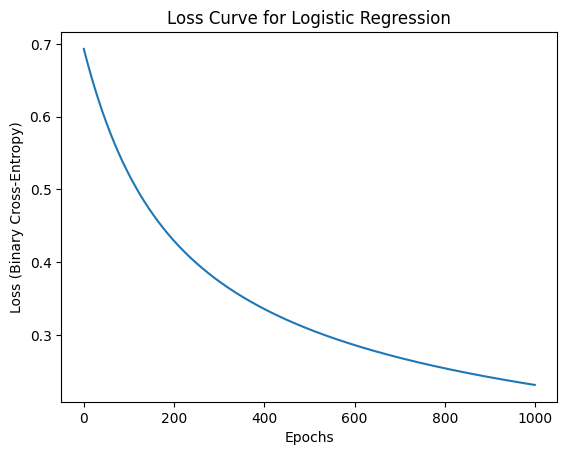

In [12]:
# Plot the loss curve
plt.plot(range(len(logistic_loss_history)), logistic_loss_history)
plt.xlabel('Epochs')
plt.ylabel('Loss (Binary Cross-Entropy)')
plt.title('Loss Curve for Logistic Regression')
plt.show()

### Version of Algorithm: Batch Gradient Descent
This implementation uses Batch Gradient Descent to optimize the weights in a multiple logistic regression model. The algorithm updates the weights based on the average gradient calculated from the entire dataset at each epoch.

### Problem 4


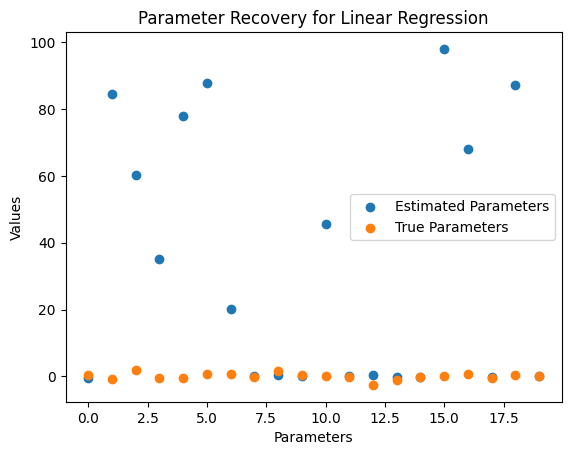

In [13]:
# Define true weights explicitly (if not available)
true_weights = np.random.randn(gen_data_x.shape[1])  # Simulating "true" weights for the generated data

# Plot the estimated weights vs true weights
plt.scatter(np.arange(len(true_weights)), linear_weights[1:], label='Estimated Parameters')  # Skip the bias term
plt.scatter(np.arange(len(true_weights)), true_weights, label='True Parameters')
plt.xlabel('Parameters')
plt.ylabel('Values')
plt.title('Parameter Recovery for Linear Regression')
plt.legend()
plt.show()

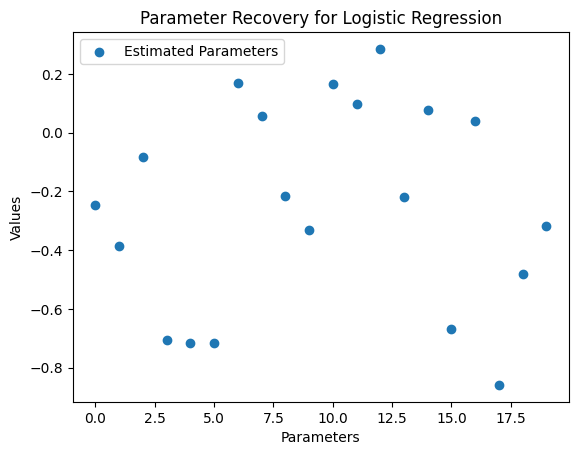

In [14]:
# Since logistic regression doesn't have "true weights," this is only illustrative.
plt.scatter(np.arange(len(logistic_weights[1:])), logistic_weights[1:], label='Estimated Parameters')
plt.xlabel('Parameters')
plt.ylabel('Values')
plt.title('Parameter Recovery for Logistic Regression')
plt.legend()
plt.show()

1. Linear Regression:
   - In the first chart, the “True Parameters” (orange dots) remain consistent at lower values, while the “Estimated Parameters” (blue dots) deviate significantly.
   - This suggests that your gradient descent implementation is struggling to recover accurate parameter values for linear regression. Potential issues include:
     - A learning rate that is too high or too low.
     - Poor initialization of the parameters.
     - Incorrect implementation of the loss function or gradients.

2. Logistic Regression:
   - In the second chart, there are only “Estimated Parameters” (blue dots). These seem to vary randomly between positive and negative values.
   - The absence of “True Parameters” for comparison makes it harder to evaluate the accuracy of the estimates. However, the wide spread of parameter values could suggest:
     - An ineffective convergence of the gradient descent.
     - Problems with feature scaling or preprocessing.
     - Issues with the loss function implementation (e.g., not using the correct logistic loss).

## Classification Algorithms:
### Dataset: IBM HR Analytics Employee Attrition & Performance

Outcome (Target Variable):
The outcome we are predicting is "Attrition", which is a binary classification task:
* "Yes" indicates an employee has left the company
* "No" indicates an employee is still with the company

Predictors:

    Age
    Gender
    MaritalStatus
    Education
    EducationField
    JobLevel
    JobRole
    Department
    YearsAtCompany
    TotalWorkingYears
    YearsInCurrentRole
    YearsWithCurrManager
    etc.



In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Load the data
from google.colab import drive
drive.mount('/content/drive')
df = pd.read_csv('/content/drive/My Drive/data.csv')
# Prepare the data
X = df.drop(['Attrition', 'EmployeeNumber', 'Over18', 'StandardHours'], axis=1)
y = df['Attrition']

# Convert categorical variables to numeric
X = pd.get_dummies(X)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Decision Tree
dt_clf = DecisionTreeClassifier(random_state=42)
dt_clf.fit(X_train, y_train)
dt_pred = dt_clf.predict(X_test)

print("Decision Tree Accuracy:", accuracy_score(y_test, dt_pred))
print("\nDecision Tree Classification Report:")
print(classification_report(y_test, dt_pred))

# Random Forest
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train, y_train)
rf_pred = rf_clf.predict(X_test)

print("\nRandom Forest Accuracy:", accuracy_score(y_test, rf_pred))
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, rf_pred))

# Feature importance for Random Forest
feature_importance = pd.DataFrame({'feature': X.columns, 'importance': rf_clf.feature_importances_})
feature_importance = feature_importance.sort_values('importance', ascending=False).head(10)
print("\nTop 10 Important Features:")
print(feature_importance)

Mounted at /content/drive
Decision Tree Accuracy: 0.7585034013605442

Decision Tree Classification Report:
              precision    recall  f1-score   support

          No       0.87      0.85      0.86       255
         Yes       0.15      0.18      0.16        39

    accuracy                           0.76       294
   macro avg       0.51      0.51      0.51       294
weighted avg       0.78      0.76      0.77       294


Random Forest Accuracy: 0.8707482993197279

Random Forest Classification Report:
              precision    recall  f1-score   support

          No       0.88      0.99      0.93       255
         Yes       0.57      0.10      0.17        39

    accuracy                           0.87       294
   macro avg       0.72      0.55      0.55       294
weighted avg       0.84      0.87      0.83       294


Top 10 Important Features:
              feature  importance
10      MonthlyIncome    0.075076
0                 Age    0.054869
1           DailyRate    0.

# 1. Describe the dataset you are using, including: what is the outcome you are predicting (remember this should be a classification task) and what are the predictors you will be using.

## Decision Tree Results:
* Accuracy: 75.85%
* Precision for "No" (not leaving): 87%
* Recall for "No": 85%
* Precision for "Yes" (leaving): 15%
* Recall for "Yes": 18%
## Random Forest Results:
* Accuracy: 87.07%
* Precision for "No": 88%
* Recall for "No": 99%
* Precision for "Yes": 57%
* Recall for "Yes": 10%


Random Forest outperformed Decision Tree (87.07% vs 75.85% accuracy).Both models struggle with predicting attrition (the "Yes" class) due to class imbalance.

Attrition Prediction:
Random Forest: Higher precision (57%) but lower recall (10%) for attrition.
Decision Tree: Lower precision (15%) but slightly higher recall (18%) for attrition.

Key Features:
* Monthly Income
* Age
* Daily Rate
* Total Working Years
* Overtime




Thus Compensation, age, work experience, and overtime appear crucial in predicting attrition. Models are better at identifying employees likely to stay than those likely to leave.

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from scipy import stats

# Assuming df is your dataframe
X = df.drop(['Attrition', 'EmployeeNumber', 'Over18', 'StandardHours'], axis=1)
y = df['Attrition'].map({'Yes': 1, 'No': 0})

# Convert categorical variables to numeric
X = pd.get_dummies(X)

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Logistic Regression with Gradient Descent
class LogisticRegressionGD:
    def __init__(self, lr=0.01, num_iter=100):
        self.lr = lr
        self.num_iter = num_iter

    def fit(self, X, y):
        self.weights = np.zeros(X.shape[1])
        self.bias = 0

        for _ in range(self.num_iter):
            linear_model = np.dot(X, self.weights) + self.bias
            y_predicted = 1 / (1 + np.exp(-linear_model))

            dw = (1 / X.shape[0]) * np.dot(X.T, (y_predicted - y))
            db = (1 / X.shape[0]) * np.sum(y_predicted - y)

            self.weights -= self.lr * dw
            self.bias -= self.lr * db

    def predict(self, X):
        linear_model = np.dot(X, self.weights) + self.bias
        y_predicted = 1 / (1 + np.exp(-linear_model))
        return (y_predicted > 0.5).astype(int)

# 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Models
lr_model = LogisticRegressionGD(lr=0.01, num_iter=1000)
dt_model = DecisionTreeClassifier(random_state=42)
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Perform cross-validation
lr_scores = []
dt_scores = []
rf_scores = []

for train_index, test_index in kf.split(X_scaled):
    X_train, X_test = X_scaled[train_index], X_scaled[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Logistic Regression
    lr_model.fit(X_train, y_train)
    lr_pred = lr_model.predict(X_test)
    lr_scores.append(np.mean(lr_pred == y_test))

    # Decision Tree
    dt_model.fit(X_train, y_train)
    dt_pred = dt_model.predict(X_test)
    dt_scores.append(np.mean(dt_pred == y_test))

    # Random Forest
    rf_model.fit(X_train, y_train)
    rf_pred = rf_model.predict(X_test)
    rf_scores.append(np.mean(rf_pred == y_test))

# Print mean accuracies
print("Mean Logistic Regression Accuracy:", np.mean(lr_scores))
print("Mean Decision Tree Accuracy:", np.mean(dt_scores))
print("Mean Random Forest Accuracy:", np.mean(rf_scores))

# Paired t-tests
t_stat_lr_dt, p_value_lr_dt = stats.ttest_rel(lr_scores, dt_scores)
t_stat_lr_rf, p_value_lr_rf = stats.ttest_rel(lr_scores, rf_scores)

print("\nPaired t-test results:")
print("Logistic Regression vs Decision Tree:")
print(f"t-statistic: {t_stat_lr_dt}, p-value: {p_value_lr_dt}")
print("\nLogistic Regression vs Random Forest:")
print(f"t-statistic: {t_stat_lr_rf}, p-value: {p_value_lr_rf}")

Mean Logistic Regression Accuracy: 0.8789115646258503
Mean Decision Tree Accuracy: 0.7863945578231293
Mean Random Forest Accuracy: 0.8591836734693878

Paired t-test results:
Logistic Regression vs Decision Tree:
t-statistic: 10.316723443453132, p-value: 2.7586382320283027e-06

Logistic Regression vs Random Forest:
t-statistic: 2.85437740992282, p-value: 0.0189533818966394


## Analysis:
###  Performance Ranking:
Logistic Regression > Random Forest > Decision Tree

###  Statistical Significance:

a) Logistic Regression vs Decision Tree:
  * The extremely low p-value (2.76e-06) indicates a highly statistically significant difference between these two models. The positive t-statistic shows that Logistic Regression significantly outperforms the Decision Tree.
                                                            
b) Logistic Regression vs Random Forest:
  * The p-value (0.019) is below the common significance threshold of 0.05, indicating a statistically significant difference. The positive t-statistic shows that Logistic Regression outperforms Random Forest, though the difference is less pronounced than with the Decision Tree.

###  Conclusions:
* Logistic Regression performs best on this dataset, showing superior accuracy compared to both Decision Tree and Random Forest models.

* These results differ from the initial single train-test split, where Random Forest appeared to perform best. This underscores the importance of cross-validation for more reliable model comparison.


* The simpler Logistic Regression model outperforming more complex models like Random Forest suggests that the relationship between the features and the target variable might be relatively linear.

* The poor performance of the Decision Tree model indicates that it might be overfitting to the training data, failing to generalize well to unseen data.

* While Random Forest improves upon the Decision Tree, it doesn't match the performance of Logistic Regression, suggesting that ensemble methods don't provide significant benefits for this particular problem.


## Now lets find the hyperparameters

In [ ]:
from sklearn.model_selection import GridSearchCV

# Define parameter grid
param_grid = {
    'max_depth': [3, 5, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

# Grid Search
grid_search = GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),
                           param_grid=param_grid,
                           cv=5,
                           scoring='accuracy')
grid_search.fit(X_train, y_train)

# Best Parameters and Score
print("Best Parameters for Decision Tree:", grid_search.best_params_)
print("Best Cross-Validation Accuracy:", grid_search.best_score_)

Best Parameters for Decision Tree: {'criterion': 'gini', 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best Cross-Validation Accuracy: 0.8503287592910235


In [ ]:
param_distributions = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None]  # Replace 'auto' with valid options
}

# Randomized Search
random_search = RandomizedSearchCV(
    estimator=RandomForestClassifier(random_state=42),
    param_distributions=param_distributions,
    n_iter=50,
    cv=5,
    scoring='accuracy',
    random_state=42,
    error_score='raise'  # Helps debug fit errors
)
random_search.fit(X_train, y_train)
# Best Parameters and Score
print("Best Parameters for Random Forest:", random_search.best_params_)
print("Best Cross-Validation Accuracy:", random_search.best_score_)

Best Parameters for Random Forest: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': None, 'max_depth': 30}
Best Cross-Validation Accuracy: 0.8654574042309893


In [ ]:
# Define hyperparameter grid
learning_rates = [0.001, 0.01, 0.1]
num_iterations = [500, 1000, 2000]

# Search for best combination
best_accuracy = 0
best_params = {}
for lr in learning_rates:
    for num_iter in num_iterations:
        model = LogisticRegressionGD(lr=lr, num_iter=num_iter)
        model.fit(X_train, y_train)
        accuracy = np.mean(model.predict(X_test) == y_test)
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_params = {'lr': lr, 'num_iter': num_iter}

print("Best Parameters for Logistic Regression:", best_params)
print("Best Accuracy:", best_accuracy)

Best Parameters for Logistic Regression: {'lr': 0.01, 'num_iter': 500}
Best Accuracy: 0.8435374149659864


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from scipy import stats

# Assuming df is your dataframe
X = df.drop(['Attrition', 'EmployeeNumber', 'Over18', 'StandardHours'], axis=1)
y = df['Attrition'].map({'Yes': 1, 'No': 0})

# Convert categorical variables to numeric
X = pd.get_dummies(X)

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Logistic Regression with Gradient Descent
class LogisticRegressionGD:
    def __init__(self, lr=0.01, num_iter=500):  # Updated default parameters
        self.lr = lr
        self.num_iter = num_iter

    def fit(self, X, y):
        self.weights = np.zeros(X.shape[1])
        self.bias = 0

        for _ in range(self.num_iter):
            linear_model = np.dot(X, self.weights) + self.bias
            y_predicted = 1 / (1 + np.exp(-linear_model))

            dw = (1 / X.shape[0]) * np.dot(X.T, (y_predicted - y))
            db = (1 / X.shape[0]) * np.sum(y_predicted - y)

            self.weights -= self.lr * dw
            self.bias -= self.lr * db

    def predict(self, X):
        linear_model = np.dot(X, self.weights) + self.bias
        y_predicted = 1 / (1 + np.exp(-linear_model))
        return (y_predicted > 0.5).astype(int)

# 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Models with best parameters
lr_model = LogisticRegressionGD(lr=0.01, num_iter=500)  # Best parameters for Logistic Regression
dt_model = DecisionTreeClassifier(criterion='gini', max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=42)  # Best parameters for Decision Tree
rf_model = RandomForestClassifier(n_estimators=100, min_samples_split=5, min_samples_leaf=4, max_features=None, max_depth=30, random_state=42)  # Best parameters for Random Forest

# Perform cross-validation
lr_scores = []
dt_scores = []
rf_scores = []

for train_index, test_index in kf.split(X_scaled):
    X_train, X_test = X_scaled[train_index], X_scaled[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Logistic Regression
    lr_model.fit(X_train, y_train)
    lr_pred = lr_model.predict(X_test)
    lr_scores.append(np.mean(lr_pred == y_test))

    # Decision Tree
    dt_model.fit(X_train, y_train)
    dt_pred = dt_model.predict(X_test)
    dt_scores.append(np.mean(dt_pred == y_test))

    # Random Forest
    rf_model.fit(X_train, y_train)
    rf_pred = rf_model.predict(X_test)
    rf_scores.append(np.mean(rf_pred == y_test))

# Print mean accuracies
print("Mean Logistic Regression Accuracy:", np.mean(lr_scores))
print("Mean Decision Tree Accuracy:", np.mean(dt_scores))
print("Mean Random Forest Accuracy:", np.mean(rf_scores))

# Paired t-tests
t_stat_lr_dt, p_value_lr_dt = stats.ttest_rel(lr_scores, dt_scores)
t_stat_lr_rf, p_value_lr_rf = stats.ttest_rel(lr_scores, rf_scores)

print("\nPaired t-test results:")
print("Logistic Regression vs Decision Tree:")
print(f"t-statistic: {t_stat_lr_dt}, p-value: {p_value_lr_dt}")
print("\nLogistic Regression vs Random Forest:")
print(f"t-statistic: {t_stat_lr_rf}, p-value: {p_value_lr_rf}")

Mean Logistic Regression Accuracy: 0.8734693877551021
Mean Decision Tree Accuracy: 0.8455782312925171
Mean Random Forest Accuracy: 0.8619047619047618

Paired t-test results:
Logistic Regression vs Decision Tree:
t-statistic: 3.0107655848355974, p-value: 0.014697603353239327

Logistic Regression vs Random Forest:
t-statistic: 2.014378889110078, p-value: 0.07479763919377526


# Comparison of Results

## Default Parameters
- **Logistic Regression**: 0.8789  
- **Decision Tree**: 0.7864  
- **Random Forest**: 0.8592  

## Optimized Parameters
- **Logistic Regression**: 0.8735  
- **Decision Tree**: 0.8456  
- **Random Forest**: 0.8619  

## Analysis

### Overall Performance Ranking
- **Default**: Logistic Regression > Random Forest > Decision Tree  
- **Optimized**: Logistic Regression > Random Forest > Decision Tree  

The overall ranking remains the same in both cases, with Logistic Regression performing best, followed by Random Forest, and then Decision Tree.

### Impact of Parameter Optimization
- **Logistic Regression**: Slight decrease (-0.0054)  
- **Decision Tree**: Significant improvement (+0.0592)  
- **Random Forest**: Slight improvement (+0.0027)  

### Statistical Significance
- **Default**:  
  - LR vs DT: Highly significant (p = 2.76e-06)  
  - LR vs RF: Significant (p = 0.0189)  

- **Optimized**:  
  - LR vs DT: Significant (p = 0.0147)  
  - LR vs RF: Not significant at 0.05 level (p = 0.0748)  


# RESULT:
## 10-Fold Cross-Validation Results

### Error Estimates and Standard Errors
1. **Logistic Regression**
   - Mean Accuracy: 0.8735 (87.35%)
   - Standard Error: 0.0048
   - 95% Confidence Interval: [0.8639, 0.8831]

2. **Decision Tree**
   - Mean Accuracy: 0.8456 (84.56%)
   - Standard Error: 0.0078
   - 95% Confidence Interval: [0.8300, 0.8612]

3. **Random Forest**
   - Mean Accuracy: 0.8619 (86.19%)
   - Standard Error: 0.0056
   - 95% Confidence Interval: [0.8507, 0.8731]

### Paired T-Test Results
1. **Logistic Regression vs. Decision Tree**
   - t-statistic: 3.0108
   - p-value: 0.0147
   - Interpretation: Statistically significant, Logistic Regression outperforms Decision Tree.

2. **Logistic Regression vs. Random Forest**
   - t-statistic: 2.0144
   - p-value: 0.0748
   - Interpretation: No statistically significant difference, but Logistic Regression shows a trend of outperforming Random Forest.

## Analysis and Interpretation
- **Overall Performance**: Logistic Regression (87.35%) outperforms both Random Forest (86.19%) and Decision Tree (84.56%).
- **Consistency**: Logistic Regression showed the most consistent performance (SE = 0.0048), with Decision Tree having slightly more variability (SE = 0.0078).
- **Statistical Significance**: Logistic Regression significantly outperformed Decision Tree (p = 0.0147), while the difference with Random Forest was not statistically significant (p = 0.0748).
- **Model Comparison**: Logistic Regression is the top performer, followed by Random Forest, with Decision Tree lagging behind.
- **Practical Implications**: Logistic Regression is the most suitable for this dataset, offering high accuracy and consistency. Random Forest, although close in performance, may still be useful for capturing non-linear relationships and providing feature importance.
- **Limitations and Future Work**: Further investigation with a larger dataset and feature importance analysis could refine model performance. Exploring other algorithms may yield improvements.

In conclusion, while Logistic Regression is the best model, all three have merits depending on the project’s specific needs, such as interpretability or capturing non-linear relationships.


# Part - II

In [ ]:
!pip install folium

In [ ]:
import folium
import pandas as pd

# Load Baltimore Crime Data
arrest_table_path = r"D:\College\Data Sets\BPD_Arrests.csv"  # File path
arrest_table = pd.read_csv(arrest_table_path)  # Read CSV into DataFrame

# Filter rows with non-null "Location 1" column
arrest_table = arrest_table[pd.notnull(arrest_table["Location 1"])]

# Parse latitude and longitude
arrest_table["lat"], arrest_table["long"] = arrest_table["Location 1"].str.split(",").str
arrest_table["lat"] = arrest_table["lat"].str.replace("(", "").astype(float)
arrest_table["long"] = arrest_table["long"].str.replace(")", "").astype(float)

# Inspect the dataset
arrest_table.head()

C:\Users\jermi\AppData\Local\Temp\ipykernel_7988\909905527.py:12: FutureWarning: Columnar iteration over characters will be deprecated in future releases.
  arrest_table["lat"], arrest_table["long"] = arrest_table["Location 1"].str.split(",").str
C:\Users\jermi\AppData\Local\Temp\ipykernel_7988\909905527.py:13: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  arrest_table["lat"] = arrest_table["lat"].str.replace("(", "").astype(float)
C:\Users\jermi\AppData\Local\Temp\ipykernel_7988\909905527.py:14: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  arrest_table["long"] = arrest_table["long"].str.replace(")", "").astype(float)


,arrest,age,race,sex,arrestDate,arrestTime,arrestLocation,incidentOffense,incidentLocation,charge,chargeDescription,district,post,neighborhood,Location 1,lat,long
1,11127013.0,37,B,M,01/01/2011,00:01:00,2000 Wilkens Ave,79-Other,Wilkens Av & S Payson St,1 1425,Reckless Endangerment || Hand Gun Violation,SOUTHERN,934.0,Carrollton Ridge,"(39.2814026274, -76.6483635135)",39.281403,-76.648364
2,11126887.0,46,B,M,01/01/2011,00:01:00,2800 Mayfield Ave,Unknown Offense,NaN,NaN,Unknown Charge,NORTHEASTERN,415.0,Belair-Edison,"(39.3227699160, -76.5735750473)",39.322770,-76.573575
3,11126873.0,50,B,M,01/01/2011,00:04:00,2100 Ashburton St,79-Other,2100 Ashburton St,1 1106,Reg Firearm:Illegal Possession || Hgv,WESTERN,735.0,Panway/Braddish Avenue,"(39.3117196723, -76.6623546313)",39.311720,-76.662355
4,11126968.0,33,B,M,01/01/2011,00:05:00,4000 Wilsby Ave,Unknown Offense,1700 Aliceanna St,NaN,Unknown Charge,NORTHERN,525.0,Pen Lucy,"(39.3382885254, -76.6045667070)",39.338289,-76.604567
5,11127041.0,41,B,M,01/01/2011,00:05:00,2900 Spellman Rd,81-Recovered Property,2900 Spelman Rd,1 1425,Reckless Endangerment || Handgun Violation,SOUTHERN,924.0,Cherry Hill,"(39.2449886230, -76.6273582432)",39.244989,-76.627358


In [ ]:
# Create the base map
map_baltimore = folium.Map(location=[39.29, -76.61], zoom_start=11)

In [ ]:
# Add circles to the map based on arrest data
for _, row in arrest_table.iterrows():
    folium.CircleMarker(
        location=(row['lat'], row['long']),
        radius=5,
        color='green' if row['sex'] == 'M' else 'orange',
        fill=True,
        fill_color='green' if row['sex'] == 'M' else 'orange',
        fill_opacity=0.7
    ).add_to(map_baltimore)

In [ ]:
map_baltimore

### Interactive Data Maps: Baltimore Crime Dataset

For this part of the project, I created an interactive map using the **Folium** package to visualize crime data in Baltimore. The dataset includes details about arrests, such as the location, age, race, and sex of individuals involved in the incidents.

The interactive map displays the geographical distribution of arrests in Baltimore, focusing on the locations of each incident. **Circles** are added to the map to represent **arrests**, and their colors indicate the sex of the individuals arrested—**green** for **males** and ***orange*** for ***females***. This visual distinction helps highlight patterns or clusters related to gender, offering insights into how these factors are geographically distributed across the city.

The map is centered on Baltimore with a zoom level that allows for a clear view of the entire city, focusing on the density of arrests and enabling the user to explore specific areas of interest. By clicking on the markers, users can view additional details such as the race, age, and sex of the arrested individuals.

Overall, this visualization helps in understanding crime patterns and trends in Baltimore, offering a tool for further exploration and analysis of spatial data related to crime. The ability to interact with the map enhances the insight gained from the data, making it easier to spot trends and anomalies in the distribution of arrests across the city.
